<a href="https://colab.research.google.com/github/NishatVasker/XAI_-Explainable_AI-/blob/main/Practice_Lung_ai%2Bxai%2Bml.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Data source: https://www.kaggle.com/datasets/shantanugarg274/lung-cancer-prediction-dataset


In [2]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 4.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=744bcc4dcfa9b3652b6e0af09c4f9be2a9bf524e28d6f897f814bfbc3129ac4d
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import shap
import lime
import lime.lime_tabular
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import warnings
warnings.filterwarnings("ignore")

# Load dataset
df = pd.read_csv("/content/Lung Cancer Dataset.csv")


Random Forest Accuracy: 0.9130
              precision    recall  f1-score   support

           0       0.92      0.93      0.92       571
           1       0.90      0.89      0.90       429

    accuracy                           0.91      1000
   macro avg       0.91      0.91      0.91      1000
weighted avg       0.91      0.91      0.91      1000



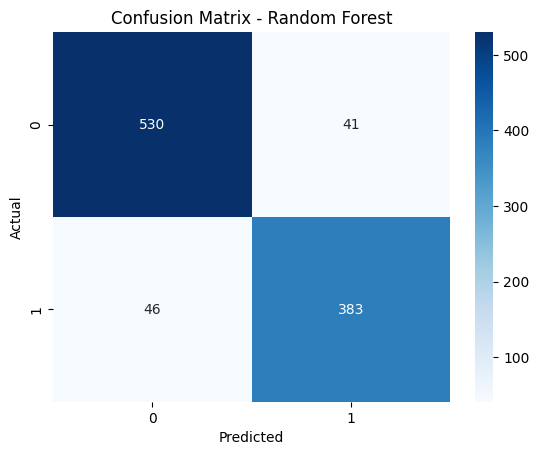


Logistic Regression Accuracy: 0.9100
              precision    recall  f1-score   support

           0       0.93      0.91      0.92       571
           1       0.88      0.91      0.90       429

    accuracy                           0.91      1000
   macro avg       0.91      0.91      0.91      1000
weighted avg       0.91      0.91      0.91      1000



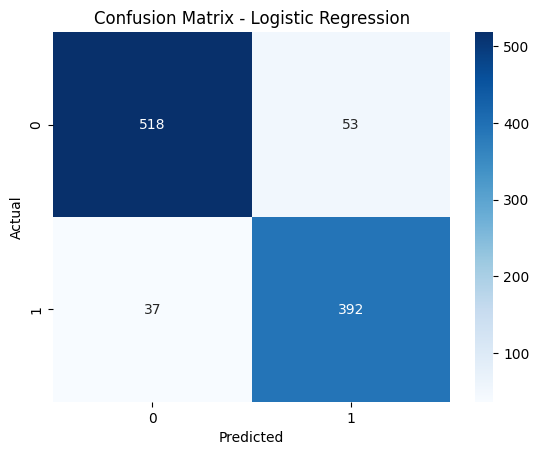


SVM Accuracy: 0.8950
              precision    recall  f1-score   support

           0       0.91      0.90      0.91       571
           1       0.87      0.89      0.88       429

    accuracy                           0.90      1000
   macro avg       0.89      0.89      0.89      1000
weighted avg       0.90      0.90      0.90      1000



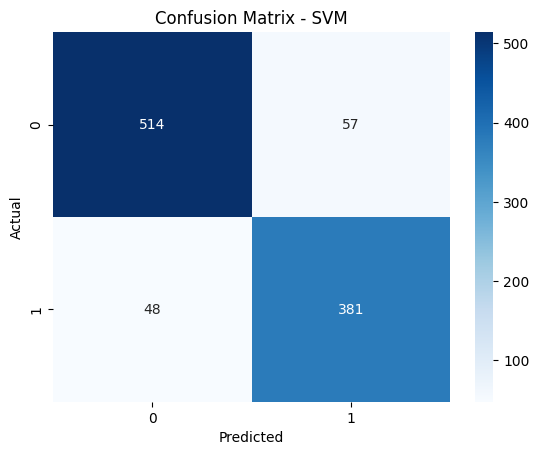


Decision Tree Accuracy: 0.8340
              precision    recall  f1-score   support

           0       0.85      0.86      0.86       571
           1       0.81      0.80      0.81       429

    accuracy                           0.83      1000
   macro avg       0.83      0.83      0.83      1000
weighted avg       0.83      0.83      0.83      1000



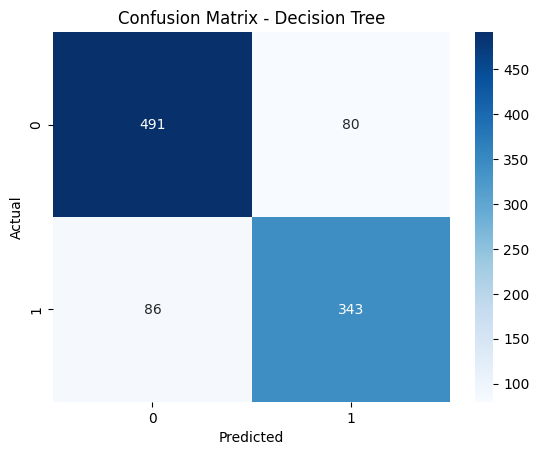


KNN Accuracy: 0.8710
              precision    recall  f1-score   support

           0       0.90      0.87      0.88       571
           1       0.83      0.88      0.85       429

    accuracy                           0.87      1000
   macro avg       0.87      0.87      0.87      1000
weighted avg       0.87      0.87      0.87      1000



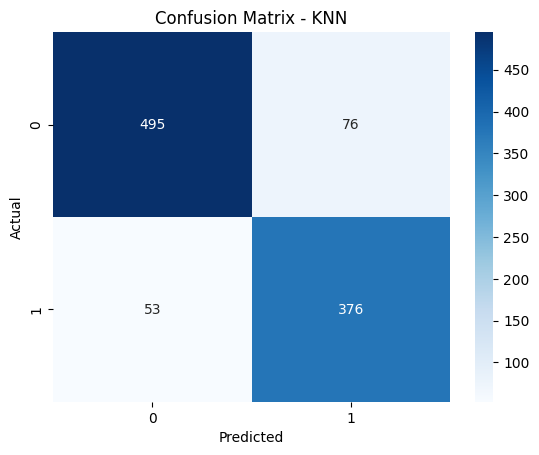


Naive Bayes Accuracy: 0.8750
              precision    recall  f1-score   support

           0       0.91      0.86      0.89       571
           1       0.83      0.89      0.86       429

    accuracy                           0.88      1000
   macro avg       0.87      0.88      0.87      1000
weighted avg       0.88      0.88      0.88      1000



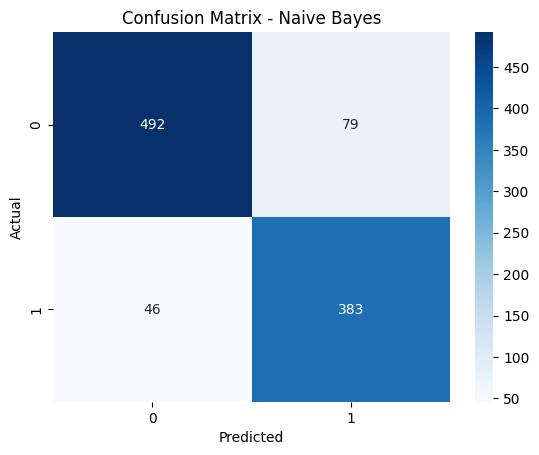


Gradient Boosting Accuracy: 0.9010
              precision    recall  f1-score   support

           0       0.91      0.92      0.91       571
           1       0.89      0.88      0.88       429

    accuracy                           0.90      1000
   macro avg       0.90      0.90      0.90      1000
weighted avg       0.90      0.90      0.90      1000



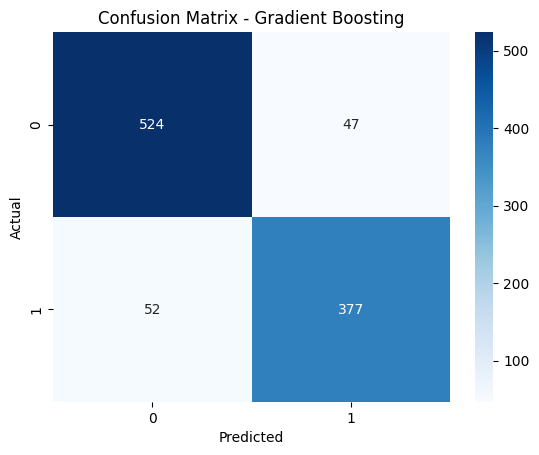

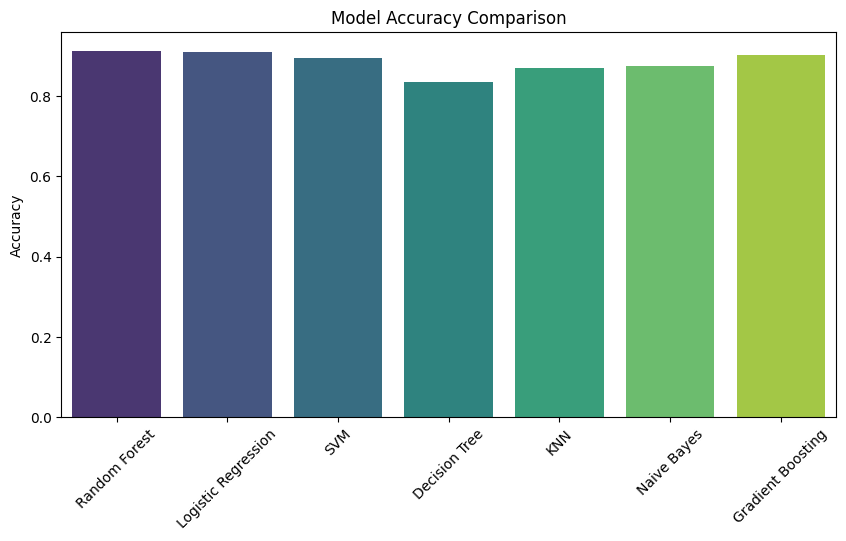

In [5]:
# Encode categorical variables
le = LabelEncoder()
df['PULMONARY_DISEASE'] = le.fit_transform(df['PULMONARY_DISEASE'])

# Feature selection
features = df.drop('PULMONARY_DISEASE', axis=1)
target = df['PULMONARY_DISEASE']

# Encode categorical features
features = features.apply(lambda col: le.fit_transform(col) if col.dtype == 'object' else col)

# Split data
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Standardization
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Define models
models = {
    'Random Forest': RandomForestClassifier(n_estimators=100, random_state=42),
    'Logistic Regression': LogisticRegression(max_iter=500),
    'SVM': SVC(),
    'Decision Tree': DecisionTreeClassifier(),
    'KNN': KNeighborsClassifier(),
    'Naive Bayes': GaussianNB(),
    'Gradient Boosting': GradientBoostingClassifier()
}

# Train and evaluate models
accuracy_results = {}
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    accuracy_results[name] = acc
    print(f'\n{name} Accuracy: {acc:.4f}')
    print(classification_report(y_test, y_pred))

    # Confusion Matrix
    plt.figure()
    sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix - {name}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Plot accuracy comparison
plt.figure(figsize=(10, 5))
sns.barplot(x=list(accuracy_results.keys()), y=list(accuracy_results.values()), palette='viridis')
plt.xticks(rotation=45)
plt.ylabel('Accuracy')
plt.title('Model Accuracy Comparison')
plt.show()



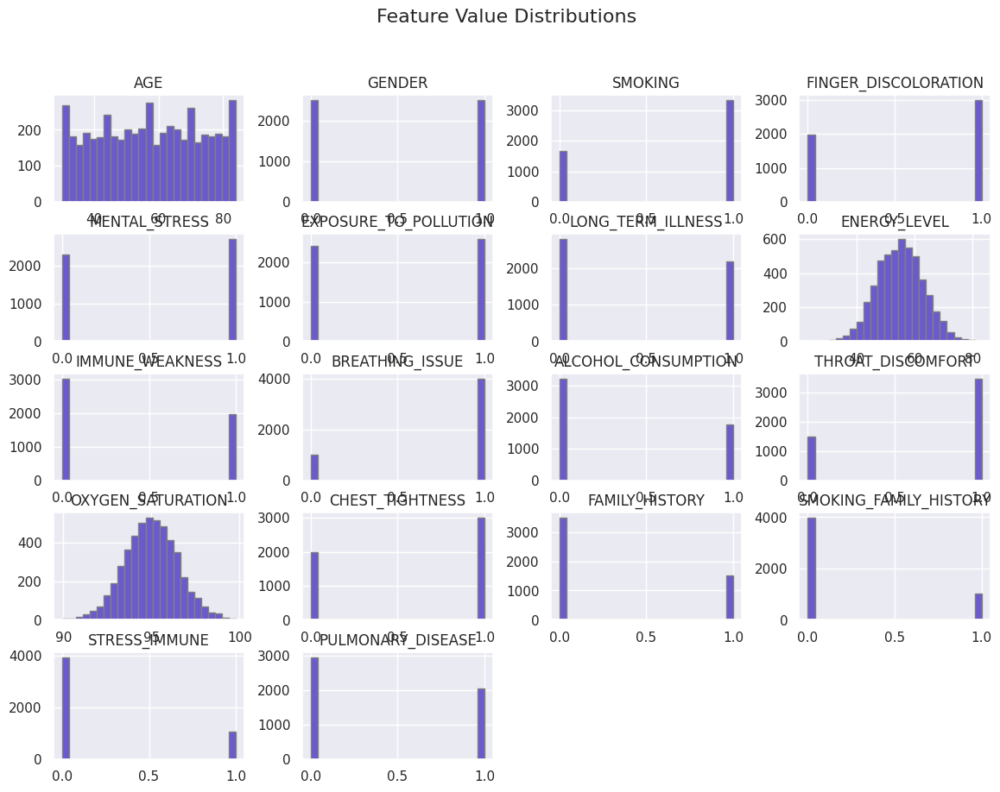

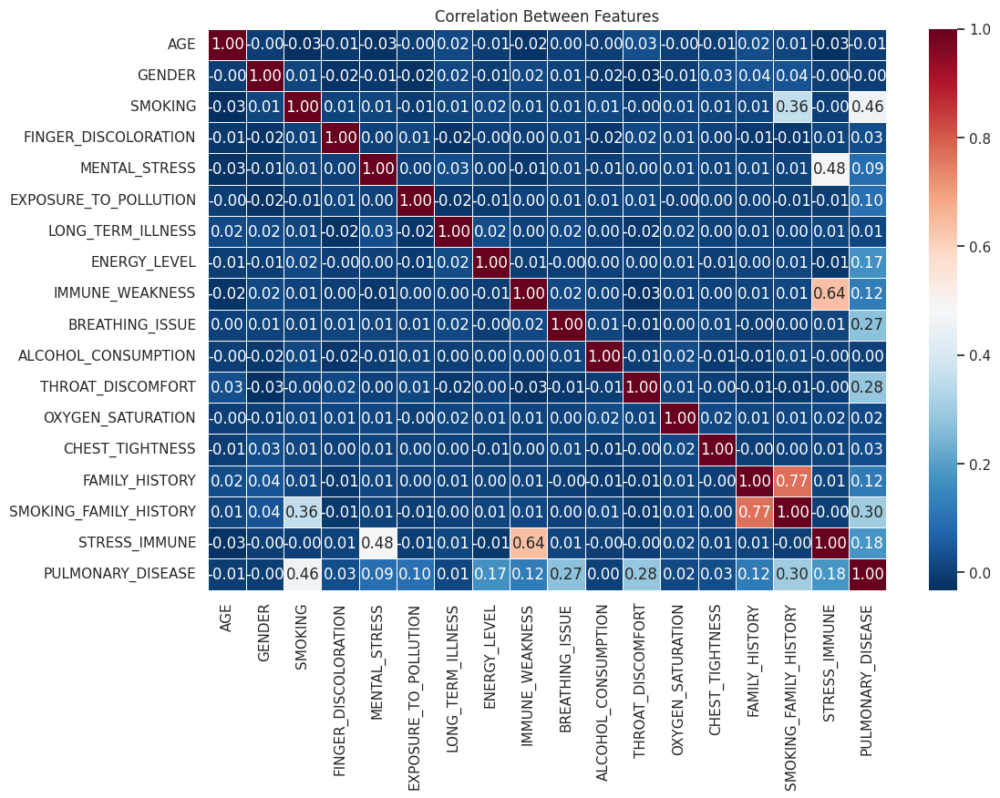

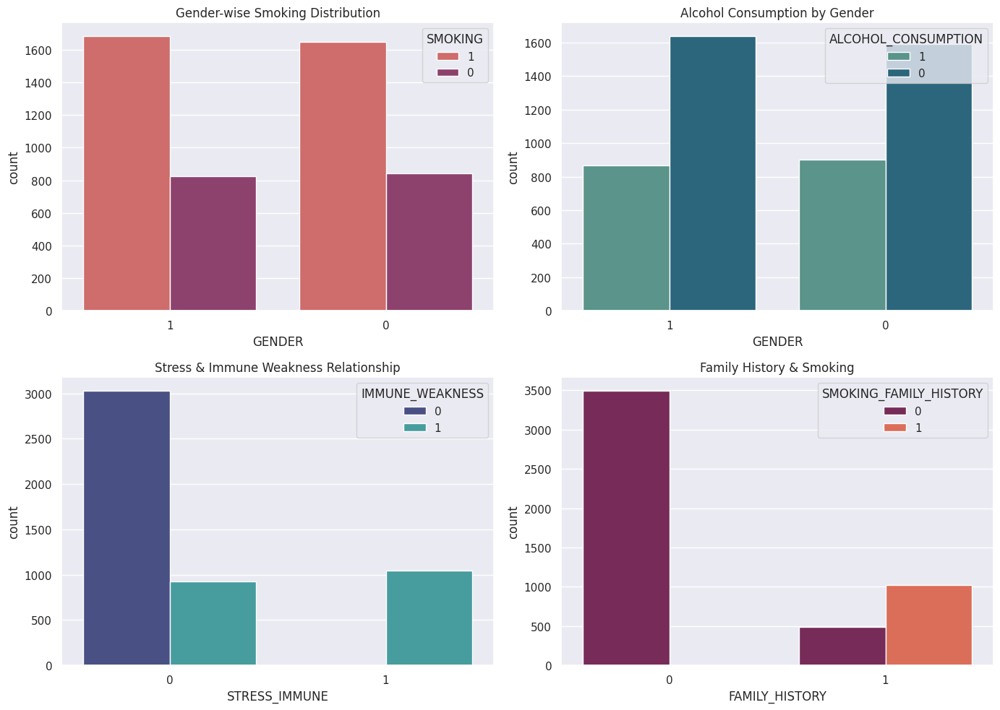

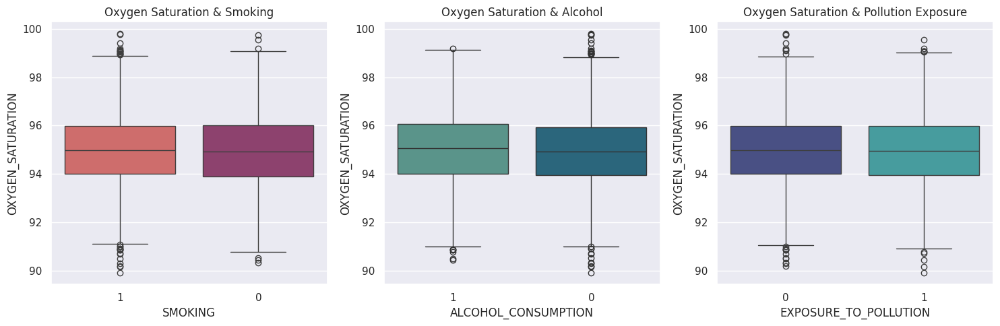

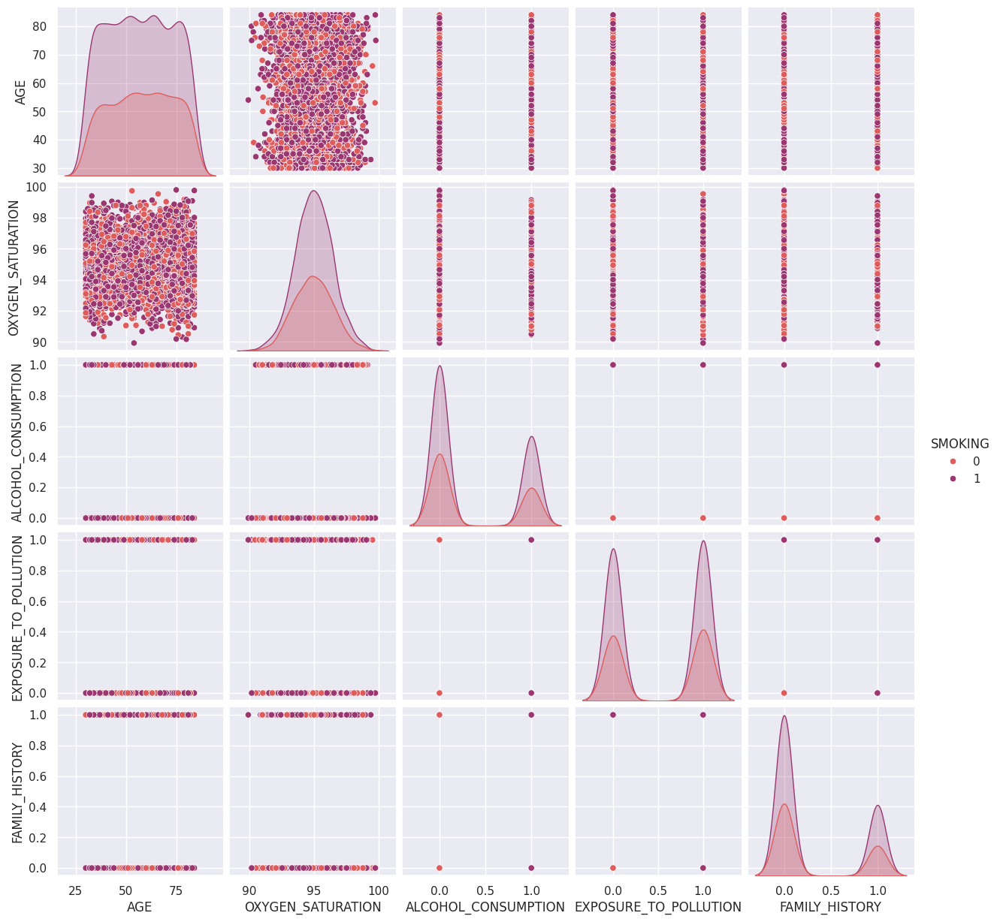

In [31]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

# Copy dataset and encode categorical features
data_transformed = df.copy()
encoders = {}

for feature in data_transformed.select_dtypes(include=['object']).columns:
    encoders[feature] = LabelEncoder()
    data_transformed[feature] = encoders[feature].fit_transform(data_transformed[feature])

# Set visualization style
sns.set(style="darkgrid")

# 🔹 Feature Distributions (Numerical Features)
data_transformed.hist(figsize=(14, 10), bins=25, color="slateblue", edgecolor="gray")
plt.suptitle("Feature Value Distributions", fontsize=16)
plt.show()

# 🔹 Correlation Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(data_transformed.corr(), annot=True, cmap="RdBu_r", fmt=".2f", linewidths=0.5)
plt.title("Correlation Between Features")
plt.show()

# 🔹 Stacked Bar Charts for Categorical Features
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

data_categorical = df.copy()
categorical_columns = ['GENDER', 'SMOKING', 'ALCOHOL_CONSUMPTION', 'STRESS_IMMUNE', 'IMMUNE_WEAKNESS',
                       'FAMILY_HISTORY', 'SMOKING_FAMILY_HISTORY']
for col in categorical_columns:
    data_categorical[col] = data_categorical[col].astype(str)

# Smoking vs Gender
sns.countplot(x="GENDER", hue="SMOKING", data=data_categorical, ax=axes[0, 0], palette="flare")
axes[0, 0].set_title("Gender-wise Smoking Distribution")

# Alcohol vs Gender
sns.countplot(x="GENDER", hue="ALCOHOL_CONSUMPTION", data=data_categorical, ax=axes[0, 1], palette="crest")
axes[0, 1].set_title("Alcohol Consumption by Gender")

# Stress vs Immune Weakness
sns.countplot(x="STRESS_IMMUNE", hue="IMMUNE_WEAKNESS", data=data_categorical, ax=axes[1, 0], palette="mako")
axes[1, 0].set_title("Stress & Immune Weakness Relationship")

# Family History vs Smoking Family History
sns.countplot(x="FAMILY_HISTORY", hue="SMOKING_FAMILY_HISTORY", data=data_categorical, ax=axes[1, 1], palette="rocket")
axes[1, 1].set_title("Family History & Smoking")

plt.tight_layout()
plt.show()

# 🔹 Boxplots: Risk Factors vs Oxygen Saturation
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

sns.boxplot(x="SMOKING", y="OXYGEN_SATURATION", data=data_categorical, ax=axes[0], palette="flare")
axes[0].set_title("Oxygen Saturation & Smoking")

sns.boxplot(x="ALCOHOL_CONSUMPTION", y="OXYGEN_SATURATION", data=data_categorical, ax=axes[1], palette="crest")
axes[1].set_title("Oxygen Saturation & Alcohol")

sns.boxplot(x="EXPOSURE_TO_POLLUTION", y="OXYGEN_SATURATION", data=data_categorical, ax=axes[2], palette="mako")
axes[2].set_title("Oxygen Saturation & Pollution Exposure")

plt.tight_layout()
plt.show()

# 🔹 Pairplot of Selected Features
data_pairplot = df.copy()
pairplot_features = ["SMOKING", "ALCOHOL_CONSUMPTION", "EXPOSURE_TO_POLLUTION", "FAMILY_HISTORY"]
for column in pairplot_features:
    data_pairplot[column] = LabelEncoder().fit_transform(data_pairplot[column])

selected_numerical_features = ["AGE", "OXYGEN_SATURATION", "SMOKING", "ALCOHOL_CONSUMPTION", "EXPOSURE_TO_POLLUTION", "FAMILY_HISTORY"]
data_numeric = data_pairplot[selected_numerical_features]

sns.pairplot(data_numeric, hue="SMOKING", palette="flare")
plt.show()


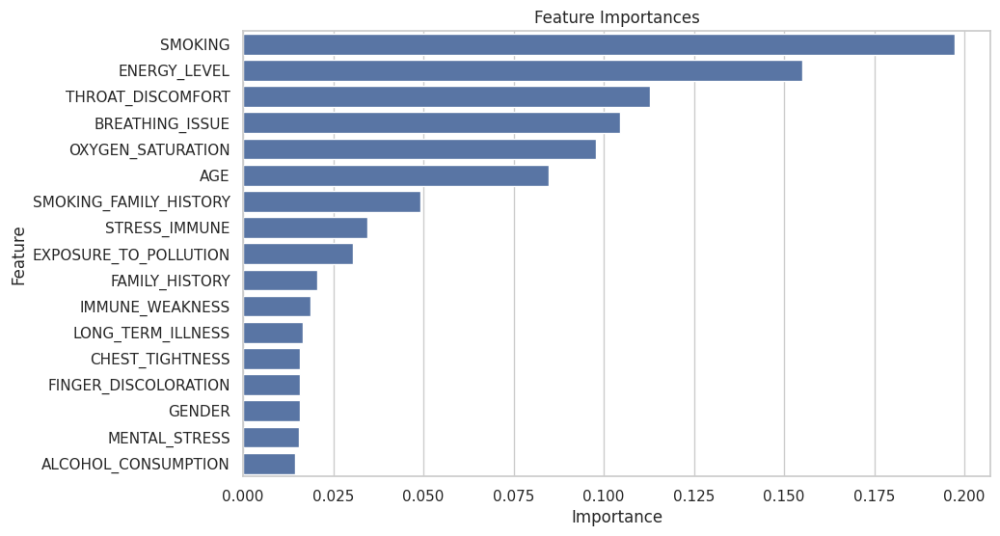

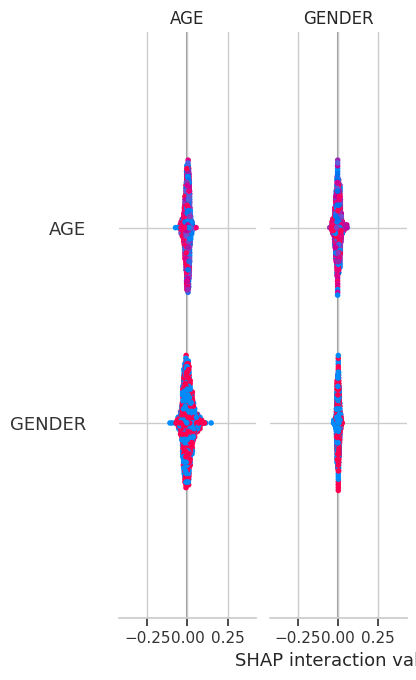

In [33]:
# prompt: if need any more classification

# Assuming 'model' is the trained model you want to use for prediction
# Example using the RandomForestClassifier

# Get feature importances
importances = models['Random Forest'].feature_importances_

# Create a DataFrame for better visualization
feature_importances = pd.DataFrame({'Feature': features.columns, 'Importance': importances})
feature_importances = feature_importances.sort_values(by='Importance', ascending=False)

# Plot feature importances
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importances)
plt.title('Feature Importances')
plt.show()

# SHAP values
explainer = shap.TreeExplainer(models['Random Forest'])
shap_values = explainer.shap_values(X_test)

# Summarize the effects of all the features
shap.summary_plot(shap_values, X_test, feature_names=features.columns)


# LIME
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train,
    feature_names=features.columns,
    class_names=['0','1'], # Replace with actual class names if different
    mode='classification'
)

# Choose an instance to explain
instance_index = 0  # Example: Explain the first instance in the test set
explanation = explainer.explain_instance(
    data_row=X_test[instance_index],
    predict_fn=models['Random Forest'].predict_proba
)

explanation.show_in_notebook(show_table=True)


SHAP explanation failed for Logistic Regression: Model type not yet supported by TreeExplainer: <class 'sklearn.linear_model._logistic.LogisticRegression'>
SHAP explanation failed for SVM: Model type not yet supported by TreeExplainer: <class 'sklearn.svm._classes.SVC'>


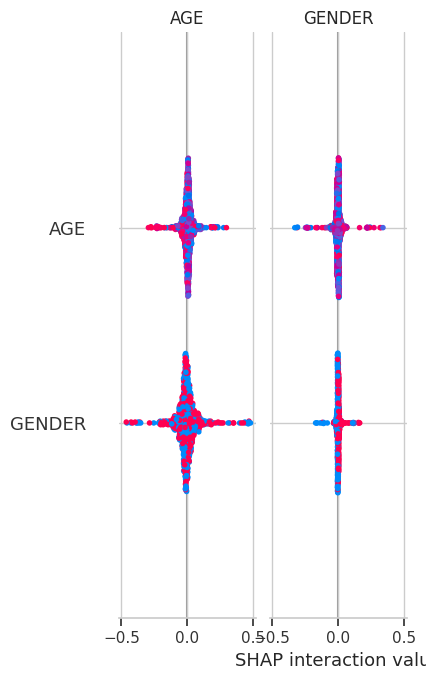

SHAP explanation failed for KNN: Model type not yet supported by TreeExplainer: <class 'sklearn.neighbors._classification.KNeighborsClassifier'>
SHAP explanation failed for Naive Bayes: Model type not yet supported by TreeExplainer: <class 'sklearn.naive_bayes.GaussianNB'>


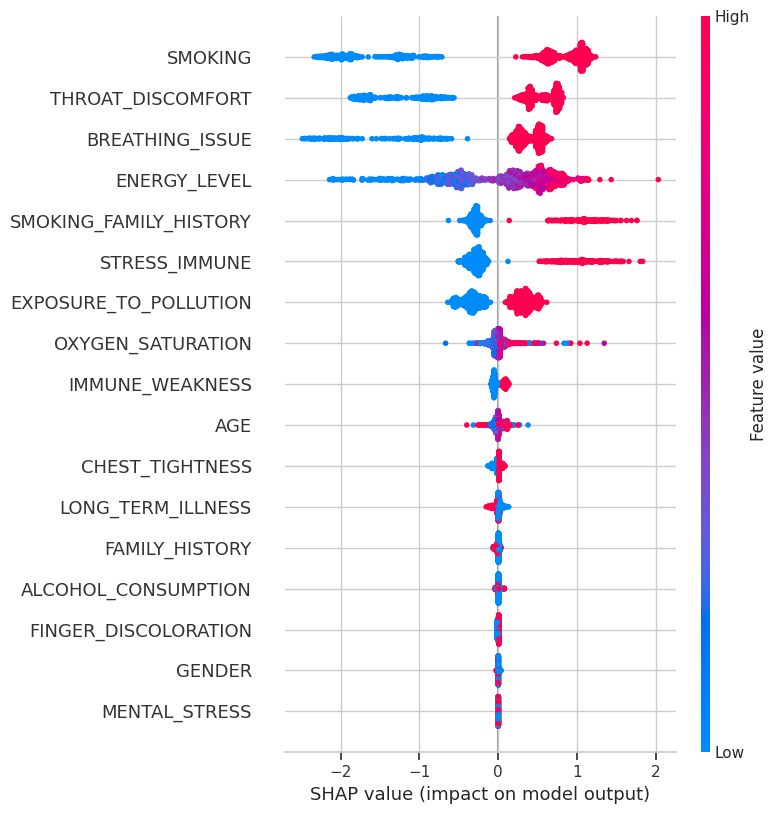

LIME explanation failed for SVM: This 'SVC' has no attribute 'predict_proba'


In [34]:
# prompt: any more xai based classification

# SHAP values for other models
for name, model in models.items():
  if name != 'Random Forest':
    try:
      explainer = shap.TreeExplainer(model)
      shap_values = explainer.shap_values(X_test)
      shap.summary_plot(shap_values, X_test, feature_names=features.columns)
    except Exception as e:
      print(f"SHAP explanation failed for {name}: {e}")

# LIME for other models
for name, model in models.items():
  if name != 'Random Forest':
    try:
      explainer = lime.lime_tabular.LimeTabularExplainer(
          training_data=X_train,
          feature_names=features.columns,
          class_names=['0', '1'],
          mode='classification'
      )
      instance_index = 0
      explanation = explainer.explain_instance(
          data_row=X_test[instance_index],
          predict_fn=model.predict_proba
      )
      explanation.show_in_notebook(show_table=True)
    except Exception as e:
      print(f"LIME explanation failed for {name}: {e}")


PermutationExplainer explainer: 1001it [00:33, 29.43it/s]                         


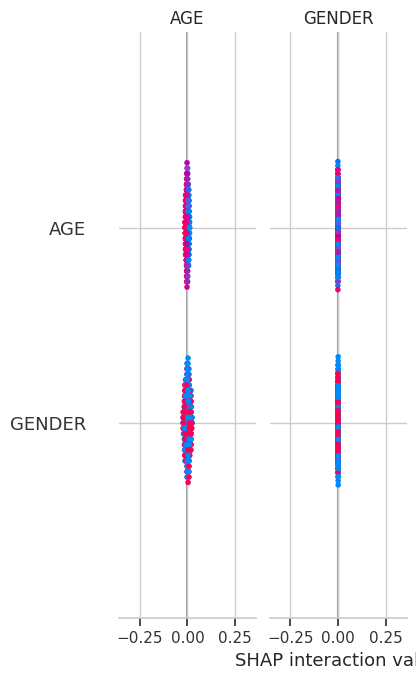

SHAP explanation skipped for SVM: predict_proba not available.


PermutationExplainer explainer: 1001it [00:16, 25.56it/s]                          


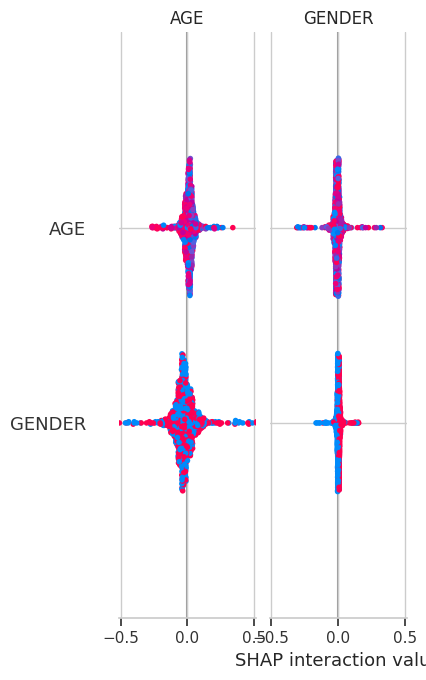

PermutationExplainer explainer: 1001it [14:25,  1.14it/s]


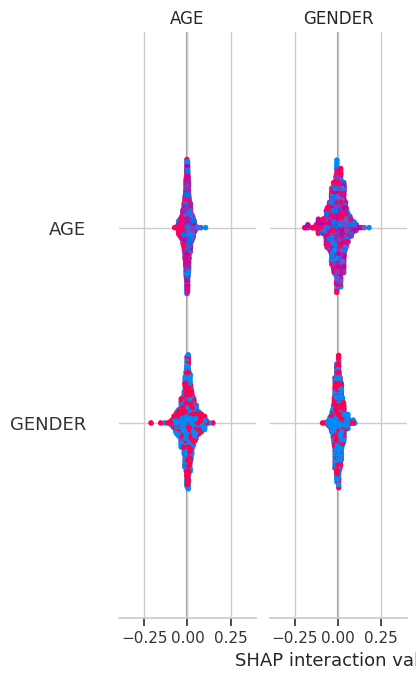

PermutationExplainer explainer: 1001it [00:24, 23.99it/s]                         


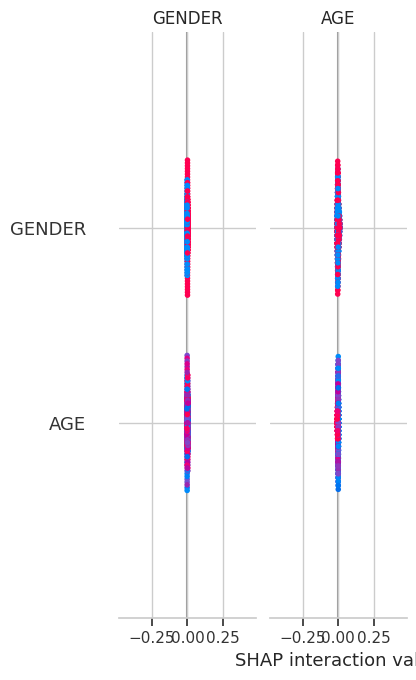

PermutationExplainer explainer: 1001it [01:07, 12.61it/s]                          


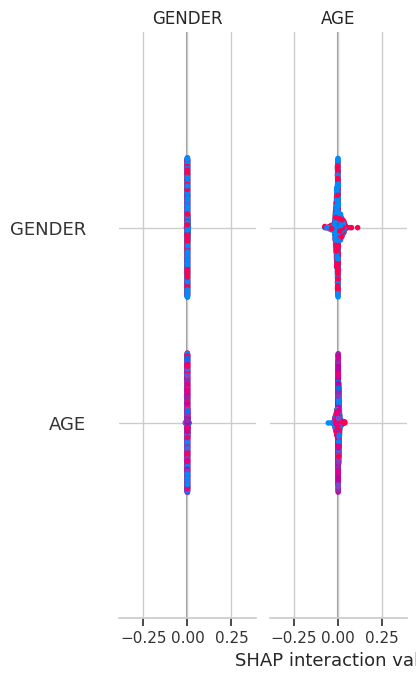

LIME explanation skipped for SVM: predict_proba not available.


In [35]:
# prompt: any more xai based classification

# ... (Your existing code)

# SHAP values for other models (improved error handling)
for name, model in models.items():
    if name != 'Random Forest':
        try:
            if hasattr(model, "predict_proba"):  # Check if the model has predict_proba
                explainer = shap.Explainer(model.predict_proba, X_train)
                shap_values = explainer(X_test)
                shap.summary_plot(shap_values, X_test, feature_names=features.columns)
            else:
                print(f"SHAP explanation skipped for {name}: predict_proba not available.")
        except Exception as e:
            print(f"SHAP explanation failed for {name}: {e}")


# LIME for other models (improved error handling)
for name, model in models.items():
    if name != 'Random Forest':
        try:
            if hasattr(model, "predict_proba"):  # Check for predict_proba
                explainer = lime.lime_tabular.LimeTabularExplainer(
                    training_data=X_train,
                    feature_names=features.columns,
                    class_names=['0', '1'],
                    mode='classification'
                )
                instance_index = 0
                explanation = explainer.explain_instance(
                    data_row=X_test[instance_index],
                    predict_fn=model.predict_proba
                )
                explanation.show_in_notebook(show_table=True)
            else:
                print(f"LIME explanation skipped for {name}: predict_proba not available.")
        except Exception as e:
            print(f"LIME explanation failed for {name}: {e}")


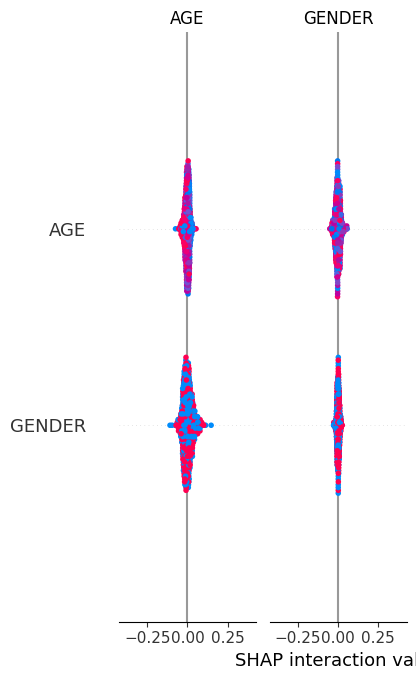

In [8]:
# SHAP for explainability (Fixed Version)
best_model = RandomForestClassifier(n_estimators=100, random_state=42)
best_model.fit(X_train, y_train)

# Use SHAP TreeExplainer for Random Forest
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test)

# Check SHAP output format
if isinstance(shap_values, list):  # For classification models
    shap_values = shap_values[1]  # Select class 1 probabilities

# SHAP summary plot
shap.summary_plot(shap_values, X_test, feature_names=features.columns)

# LIME for local interpretability
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=features.columns,
    class_names=['No', 'Yes'],
    discretize_continuous=True
)

# Explain a single prediction
idx = 5  # Example index
test_instance = X_test[idx].reshape(1, -1)  # Ensure correct shape
exp = explainer.explain_instance(test_instance.flatten(), best_model.predict_proba, num_features=5)
exp.show_in_notebook()
